In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim

def load_and_preprocess(image_path, rotate_angle=0):
    """Load image, convert to grayscale, resize, and optionally rotate."""
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Error loading image: {image_path}")
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.resize(gray, (800, 800))  # Ensuring both images have the same dimensions
    if rotate_angle != 0:
        center = (gray.shape[1] // 2, gray.shape[0] // 2)
        M = cv2.getRotationMatrix2D(center, rotate_angle, 1.0)
        gray = cv2.warpAffine(gray, M, (gray.shape[1], gray.shape[0]))
    return img, gray

def preprocess_satellite_image(image):
    """Reduce background noise while preserving main structures."""
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 11, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return clean

def detect_and_match_features(img1, img2, method='ORB'):
    """Detect and match features between two images."""
    if method == 'ORB':
        detector = cv2.ORB_create(nfeatures=500)
        matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    elif method == 'SIFT':
        detector = cv2.SIFT_create()
        matcher = cv2.FlannBasedMatcher(dict(algorithm=1, trees=5), dict(checks=50))
    else:
        raise ValueError("Unsupported feature detection method")
    
    kp1, des1 = detector.detectAndCompute(img1, None)
    kp2, des2 = detector.detectAndCompute(img2, None)
    
    if des1 is None or des2 is None:
        return None, kp1, kp2, []
    
    matches = matcher.match(des1, des2) if method == 'ORB' else matcher.knnMatch(des1, des2, k=2)
    
    if method == 'SIFT':
        good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]
    else:
        good_matches = matches
    
    matched_img = cv2.drawMatches(img1, kp1, img2, kp2, good_matches[:50], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    return matched_img, kp1, kp2, good_matches

def find_contours(image):
    """Find contours in an image, filtering out small areas."""
    edges = cv2.Canny(image, 50, 200)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return sorted([c for c in contours if cv2.contourArea(c) > 100], key=cv2.contourArea, reverse=True)[:10]

def match_contours(contours1, contours2):
    """Match contours using Hu Moments and Hausdorff distance."""
    matched_pairs = []
    for c1 in contours1:
        hu1 = cv2.HuMoments(cv2.moments(c1)).flatten()
        min_distance = float('inf')
        best_match = None
        for c2 in contours2:
            hu2 = cv2.HuMoments(cv2.moments(c2)).flatten()
            distance = np.linalg.norm(hu1 - hu2)
            if distance < min_distance:
                min_distance = distance
                best_match = c2
        if best_match is not None and min_distance < 1:
            matched_pairs.append((c1, best_match))
    return matched_pairs

def compute_ssim(img1, img2):
    """Compute structural similarity between two images."""
    img1 = cv2.resize(img1, (800, 800))
    img2 = cv2.resize(img2, (800, 800))
    score, _ = ssim(img1, img2, full=True)
    return score

def visualize_matches(img, title="Feature Matching"):
    plt.figure(figsize=(10, 5))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"  # E
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"
img1, gray1 = load_and_preprocess(satellite_path)
img2, gray2 = load_and_preprocess(cad_path)

# Preprocess satellite image to reduce background noise
gray1 = preprocess_satellite_image(img1)

# Perform multiple rotations of the CAD image
for angle in range(0, 360, 10):
    img2_rot, gray2_rot = load_and_preprocess(cad_path, rotate_angle=angle)
    orb_matches, _, _, _ = detect_and_match_features(gray1, gray2_rot, 'ORB')
    sift_matches, _, _, _ = detect_and_match_features(gray1, gray2_rot, 'SIFT')
    if orb_matches is not None:
        visualize_matches(orb_matches, f"ORB Feature Matching (Angle {angle}°)")
    if sift_matches is not None:
        visualize_matches(sift_matches, f"SIFT Feature Matching (Angle {angle}°)")

# Contour Matching
contours1 = find_contours(gray1)
contours2 = find_contours(gray2)
matched_contours = match_contours(contours1, contours2)
contour_img1 = img1.copy()
contour_img2 = img2.copy()
for c1, c2 in matched_contours:
    cv2.drawContours(contour_img1, [c1], -1, (0, 0, 255), 3)
    cv2.drawContours(contour_img2, [c2], -1, (0, 0, 255), 3)
visualize_matches(contour_img1, f"Matched Contours in Satellite Map")
visualize_matches(contour_img2, f"Matched Contours in CAD Map")

# SSIM for Image Similarity
similarity_score = compute_ssim(gray1, gray2)
print(f"SSIM Similarity Score (Original): {similarity_score:.4f}")


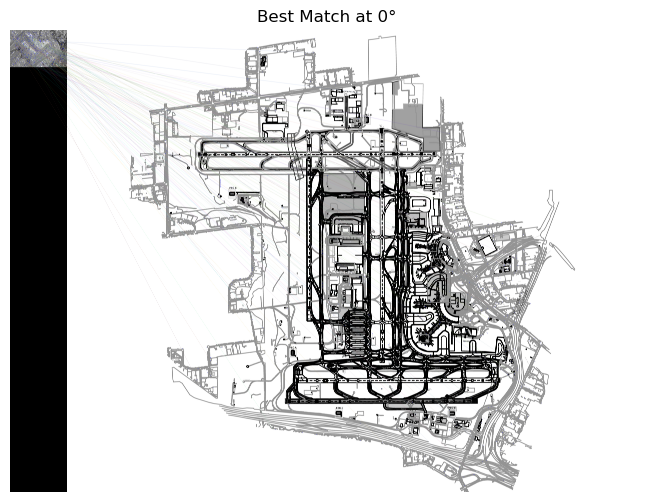

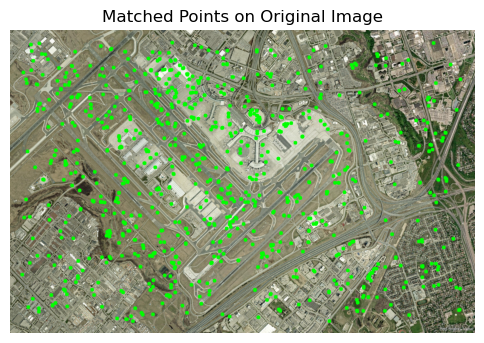

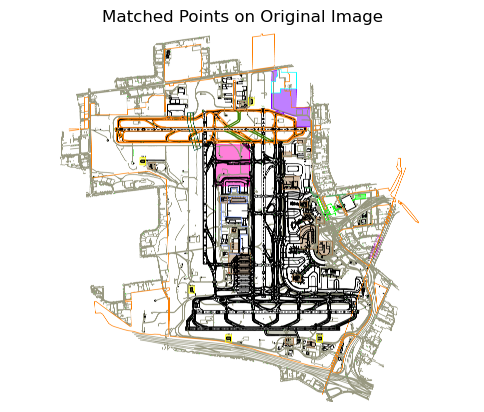

In [124]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_and_preprocess(image_path):
    """Load image, convert to grayscale, and extract edges."""
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Error loading image: {image_path}")
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 50, 150)
    return img, gray, edges

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    cos_val = np.abs(M[0, 0])
    sin_val = np.abs(M[0, 1])
    new_w = int((h * sin_val) + (w * cos_val))
    new_h = int((h * cos_val) + (w * sin_val))
    M[0, 2] += (new_w / 2) - center[0]
    M[1, 2] += (new_h / 2) - center[1]
    return cv2.warpAffine(image, M, (new_w, new_h))

def match_edge_maps(edges1, edges2):
    """Match keypoints between two edge maps using ORB."""
    orb = cv2.ORB_create(nfeatures=1000)
    kp1, des1 = orb.detectAndCompute(edges1, None)
    kp2, des2 = orb.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()


def map_matched_points(img, keypoints):
    """Draw matched keypoints onto the original image."""
    output = img.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(output, (x, y), 5, (0, 255, 0), -1)
    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title("Matched Points on Original Image")
    plt.axis('off')
    plt.show()

# Load images and extract edge maps
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"  # E
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"
img1, gray1, edges1 = load_and_preprocess(satellite_path)
img2, gray2, edges2 = load_and_preprocess(cad_path)

# Rotate CAD edges to find best alignment
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot)
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

if best_matches:
    visualize_matches(gray1, best_kp1, gray2, best_kp2, best_matches, f"Best Match at {best_angle}°")

# Map matched points back onto original images
map_matched_points(img1, best_kp1)
map_matched_points(img2, best_kp2)


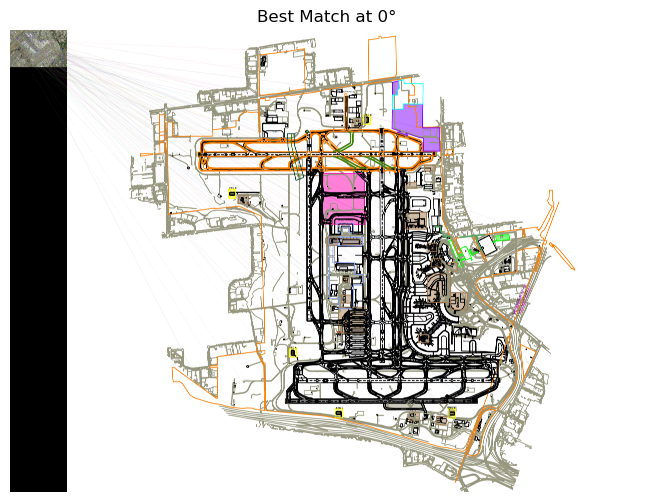

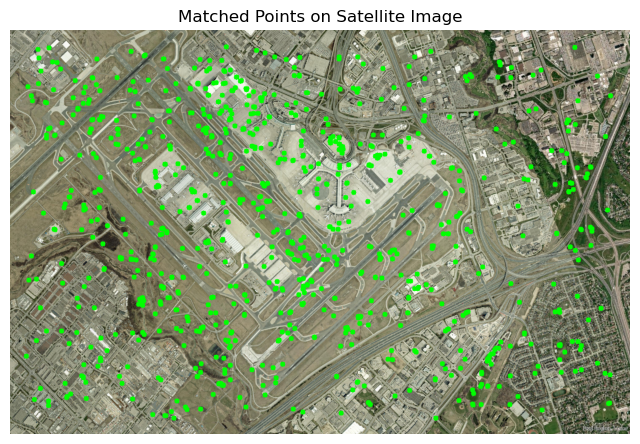

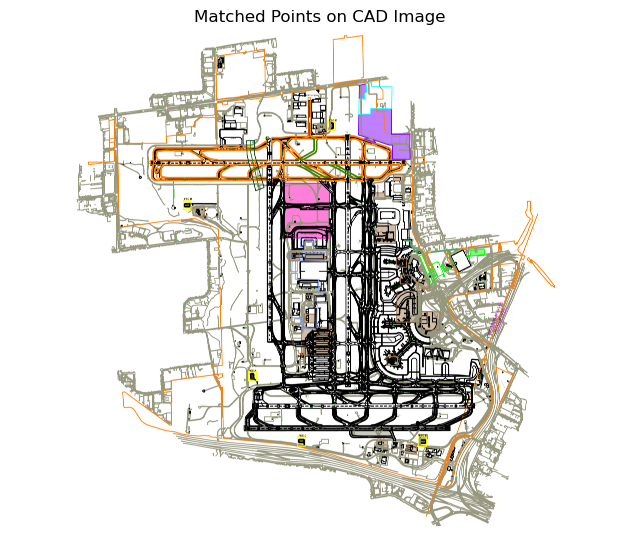

In [123]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_and_preprocess(image_path):
    """Load image, convert to grayscale, and extract edges."""
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Error loading image: {image_path}")
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 50, 150)
    return img, gray, edges

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    cos_val = np.abs(M[0, 0])
    sin_val = np.abs(M[0, 1])
    new_w = int((h * sin_val) + (w * cos_val))
    new_h = int((h * cos_val) + (w * sin_val))
    M[0, 2] += (new_w / 2) - center[0]
    M[1, 2] += (new_h / 2) - center[1]
    return cv2.warpAffine(image, M, (new_w, new_h))

def match_edge_maps(edges1, edges2):
    """Match keypoints between two edge maps using ORB."""
    orb = cv2.ORB_create(nfeatures=1000)
    kp1, des1 = orb.detectAndCompute(edges1, None)
    kp2, des2 = orb.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()


def map_matched_points(img, keypoints, title):
    """Draw matched keypoints onto the original image."""
    output = img.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(output, (x, y), 5, (0, 255, 0), -1)
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images and extract edge maps
satellite_path = r"C:\Users\twool\Downloads\GTAA.tif"
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"
img1, gray1, edges1 = load_and_preprocess(satellite_path)
img2, gray2, edges2 = load_and_preprocess(cad_path)

# Rotate CAD edges to find best alignment
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot)
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

if best_matches:
    visualize_matches(img1, best_kp1, img2, best_kp2, best_matches, f"Best Match at {best_angle}°")

# Map matched points back onto original images
map_matched_points(img1, best_kp1, "Matched Points on Satellite Image")
map_matched_points(img2, best_kp2, "Matched Points on CAD Image")


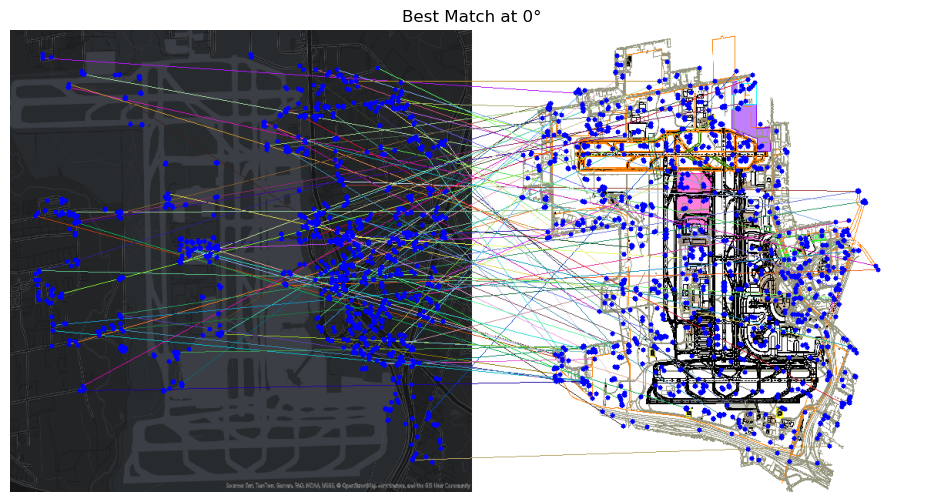

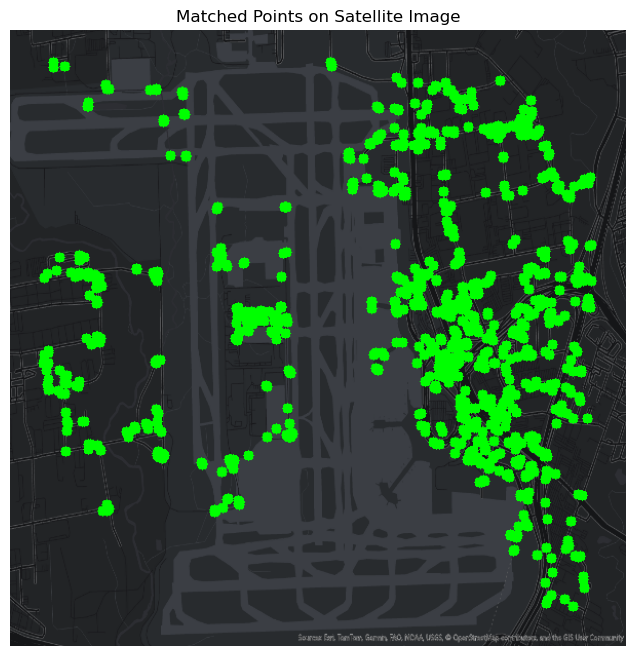

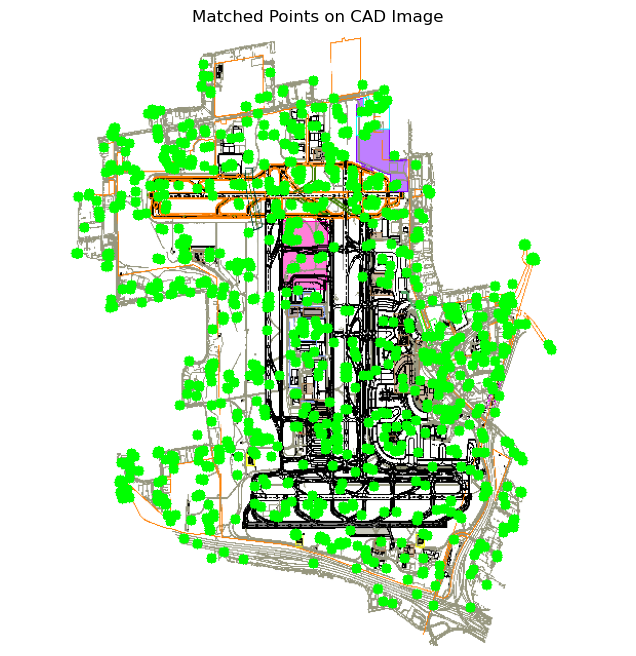

In [176]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_and_preprocess(image_path, target_size=(600, 600)):
    """Load image, resize to target size, convert to grayscale, and extract edges."""
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Error loading image: {image_path}")
    
    # Resize the image to the target size
    img_resized = cv2.resize(img, target_size)
    
    # Convert to grayscale
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    
    # Extract edges using Canny
    edges = cv2.Canny(gray, 50, 150)
    
    return img_resized, gray, edges

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2):
    """Match keypoints between two edge maps using ORB."""
    orb = cv2.ORB_create(nfeatures=1000)
    kp1, des1 = orb.detectAndCompute(edges1, None)
    kp2, des2 = orb.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()



def map_matched_points(img, keypoints, title):
    """Draw matched keypoints onto the original image."""
    output = img.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(output, (x, y), 5, (0, 255, 0), -1)
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images and extract edge maps
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"  # E
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"
img1, gray1, edges1 = load_and_preprocess(satellite_path)
img2, gray2, edges2 = load_and_preprocess(cad_path)

# Rotate CAD edges to find best alignment
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot)
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

if best_matches:
    visualize_matches(img1, best_kp1, img2, best_kp2, best_matches, f"Best Match at {best_angle}°")

# Map matched points back onto original images
map_matched_points(img1, best_kp1, "Matched Points on Satellite Image")
map_matched_points(img2, best_kp2, "Matched Points on CAD Image")



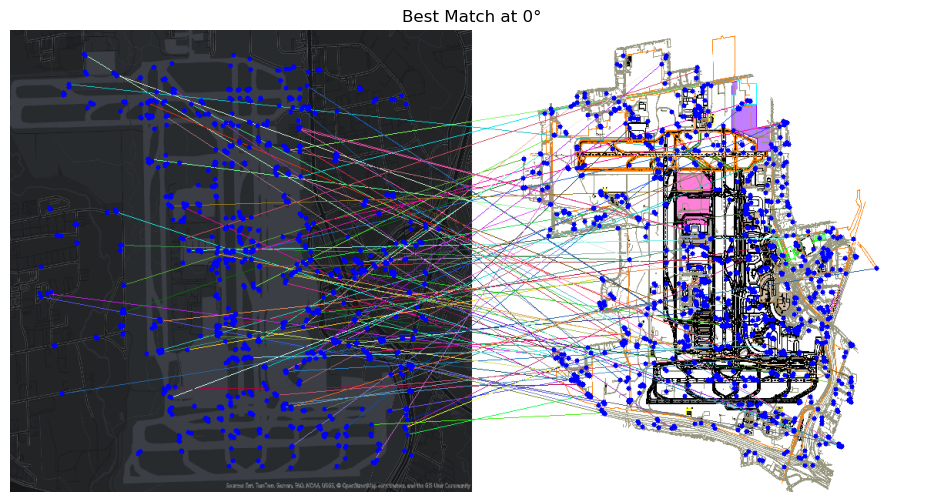

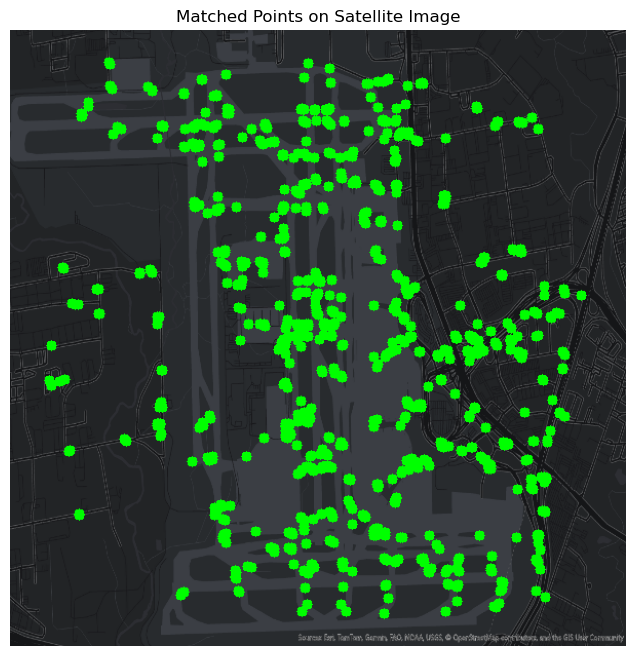

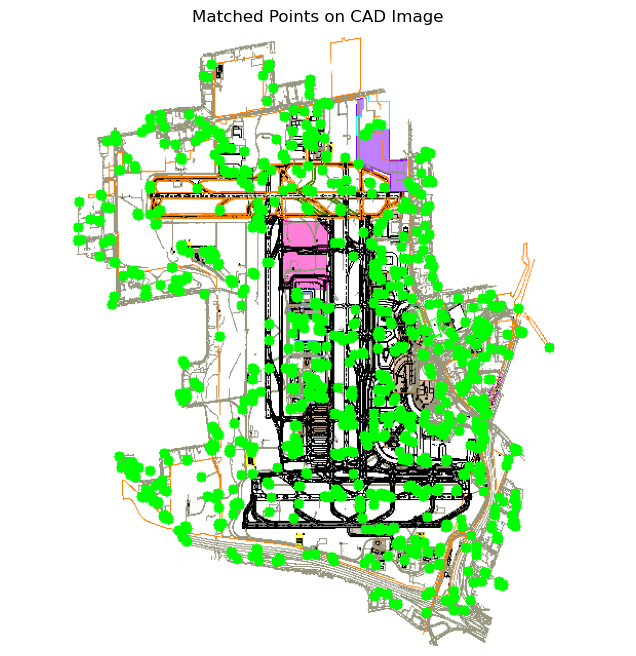

In [177]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_and_preprocess(image_path, target_size=(600, 600)):
    """Load image, resize to target size, reduce noise, eliminate background, and extract edges."""
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Error loading image: {image_path}")
    
    # Resize the image to the target size
    img_resized = cv2.resize(img, target_size)
    
    # Convert to grayscale
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian Blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Apply Otsu's thresholding to eliminate background
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Extract edges using Canny
    edges = cv2.Canny(thresh, 50, 150)
    
    return img_resized, gray, edges

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2):
    """Match keypoints between two edge maps using ORB."""
    orb = cv2.ORB_create(nfeatures=1000)
    kp1, des1 = orb.detectAndCompute(edges1, None)
    kp2, des2 = orb.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()



def map_matched_points(img, keypoints, title):
    """Draw matched keypoints onto the original image."""
    output = img.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(output, (x, y), 5, (0, 255, 0), -1)
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images and extract edge maps
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"  # E
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"
img1, gray1, edges1 = load_and_preprocess(satellite_path)
img2, gray2, edges2 = load_and_preprocess(cad_path)

# Rotate CAD edges to find best alignment
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot)
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

if best_matches:
    visualize_matches(img1, best_kp1, img2, best_kp2, best_matches, f"Best Match at {best_angle}°")

# Map matched points back onto original images
map_matched_points(img1, best_kp1, "Matched Points on Satellite Image")
map_matched_points(img2, best_kp2, "Matched Points on CAD Image")


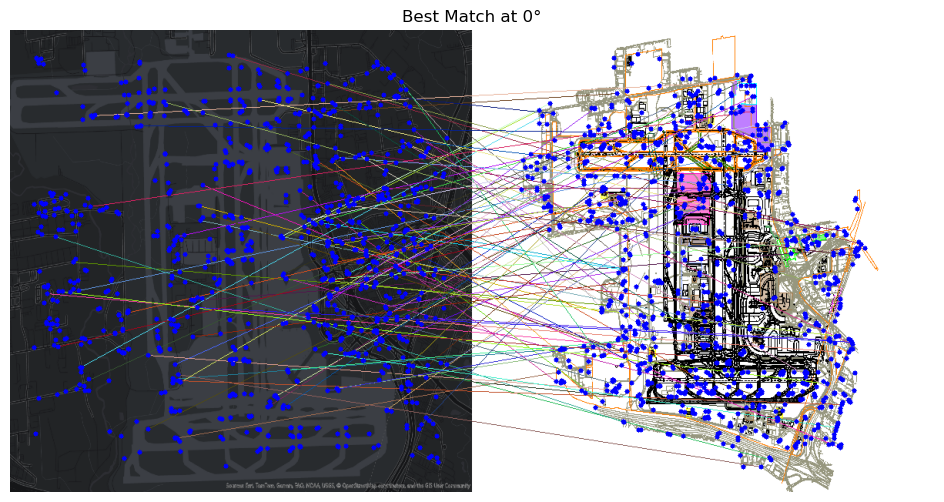

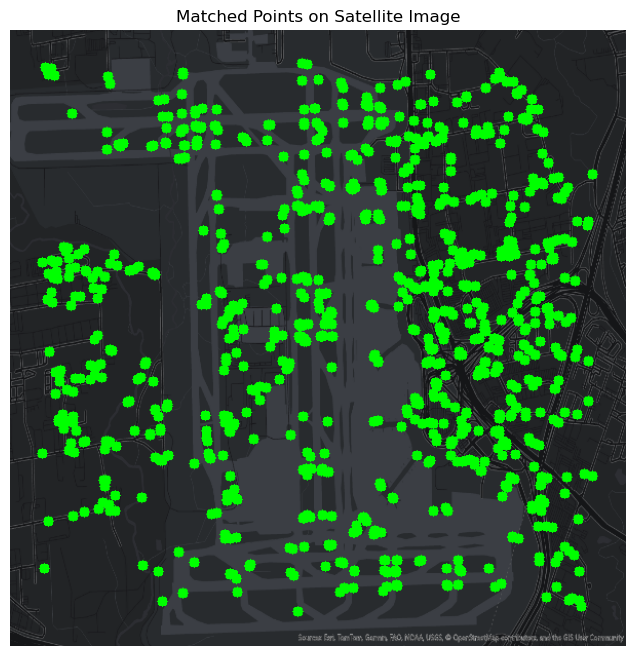

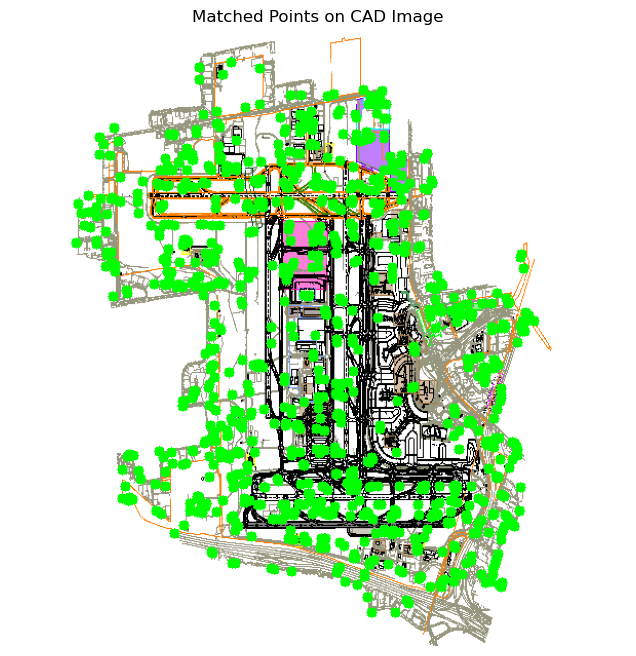

In [178]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    # Resize image to the target size
    img_resized = cv2.resize(image, target_size)
    
    # Convert to grayscale
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Adaptive thresholding to separate the main features from the background
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 11, 2)
    
    # Perform morphological opening to remove small noise (background)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return img_resized, gray, clean

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2):
    """Match keypoints between two edge maps using ORB."""
    orb = cv2.ORB_create(nfeatures=1000)
    kp1, des1 = orb.detectAndCompute(edges1, None)
    kp2, des2 = orb.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()


def map_matched_points(img, keypoints, title):
    """Draw matched keypoints onto the original image."""
    output = img.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(output, (x, y), 5, (0, 255, 0), -1)
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images and preprocess both the satellite and CAD images
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"  # E
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"

# Preprocess both images
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)

img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD edges to find best alignment
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot)
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

if best_matches:
    visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"Best Match at {best_angle}°")

# Map matched points back onto original images
map_matched_points(img1_processed, best_kp1, "Matched Points on Satellite Image")
map_matched_points(img2_processed, best_kp2, "Matched Points on CAD Image")


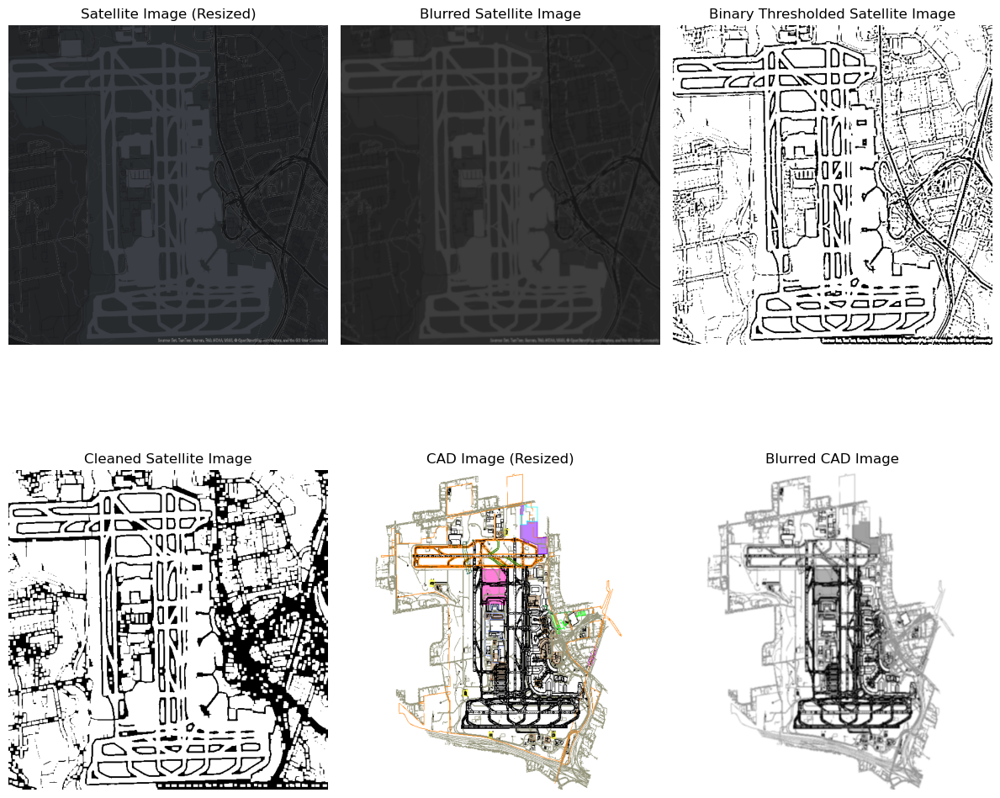

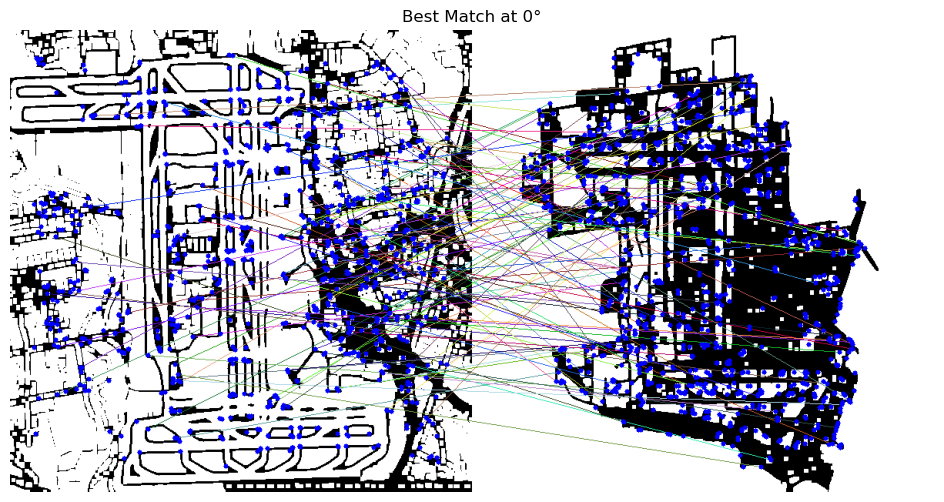

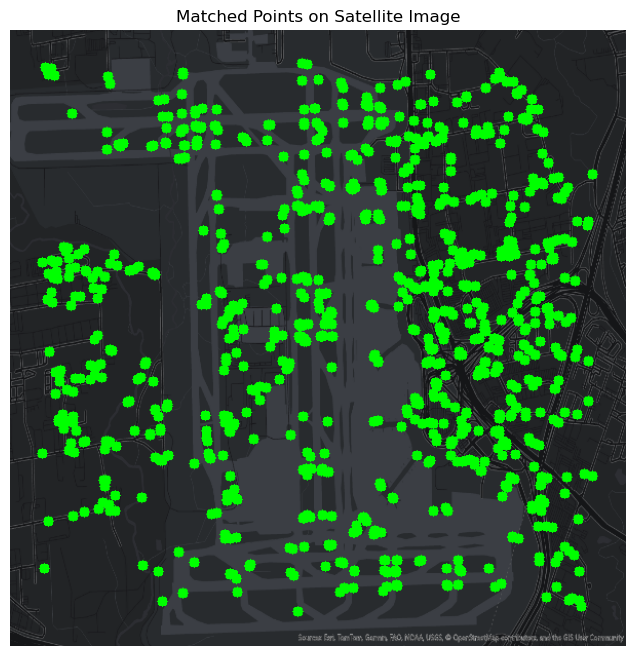

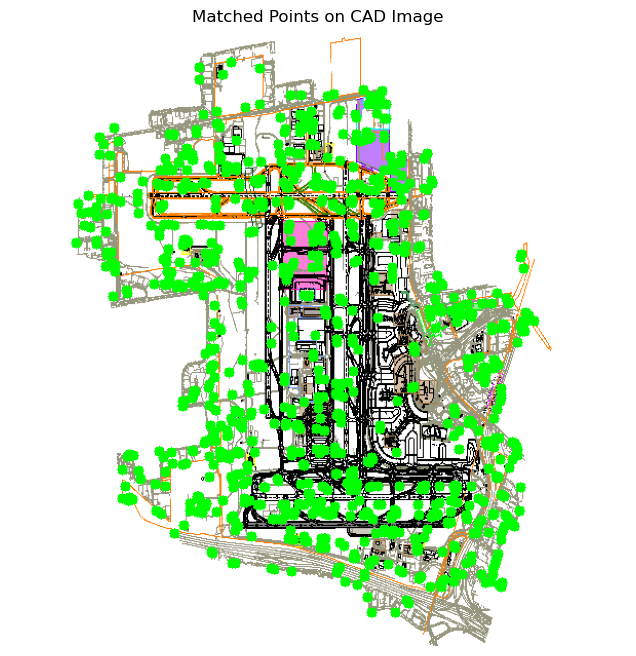

In [179]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    # Resize image to the target size
    img_resized = cv2.resize(image, target_size)
    
    # Convert to grayscale
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Adaptive thresholding to separate the main features from the background
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 11, 2)
    
    # Perform morphological opening to remove small noise (background)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return img_resized, gray, blurred, binary, clean

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2):
    """Match keypoints between two edge maps using ORB."""
    orb = cv2.ORB_create(nfeatures=1000)
    kp1, des1 = orb.detectAndCompute(edges1, None)
    kp2, des2 = orb.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()



def map_matched_points(img, keypoints, title):
    """Draw matched keypoints onto the original image."""
    output = img.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(output, (x, y), 5, (0, 255, 0), -1)
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images and preprocess both the satellite and CAD images
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"  # E
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"

# Preprocess both images
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)

img1_processed, gray1, blurred1, binary1, clean1 = preprocess_image(img1)
img2_processed, gray2, blurred2, binary2, clean2 = preprocess_image(img2)

# Visualize preprocessing steps
plt.figure(figsize=(12, 12))

# Satellite image preprocessing
plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(img1_processed, cv2.COLOR_BGR2RGB))
plt.title("Satellite Image (Resized)")
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(cv2.cvtColor(blurred1, cv2.COLOR_BGR2RGB), cmap='gray')
plt.title("Blurred Satellite Image")
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(binary1, cmap='gray')
plt.title("Binary Thresholded Satellite Image")
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(clean1, cmap='gray')
plt.title("Cleaned Satellite Image")
plt.axis('off')

# CAD image preprocessing
plt.subplot(2, 3, 5)
plt.imshow(cv2.cvtColor(img2_processed, cv2.COLOR_BGR2RGB))
plt.title("CAD Image (Resized)")
plt.axis('off')

plt.subplot(2, 3, 6)
plt.imshow(cv2.cvtColor(blurred2, cv2.COLOR_BGR2RGB), cmap='gray')
plt.title("Blurred CAD Image")
plt.axis('off')

plt.tight_layout()
plt.show()

# Rotate CAD edges to find best alignment
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(clean2, angle)
    matches, kp1, kp2 = match_edge_maps(clean1, edges2_rot)
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

if best_matches:
    visualize_matches(clean1, best_kp1, clean2, best_kp2, best_matches, f"Best Match at {best_angle}°")

# Map matched points back onto original images
map_matched_points(img1_processed, best_kp1, "Matched Points on Satellite Image")
map_matched_points(img2_processed, best_kp2, "Matched Points on CAD Image")


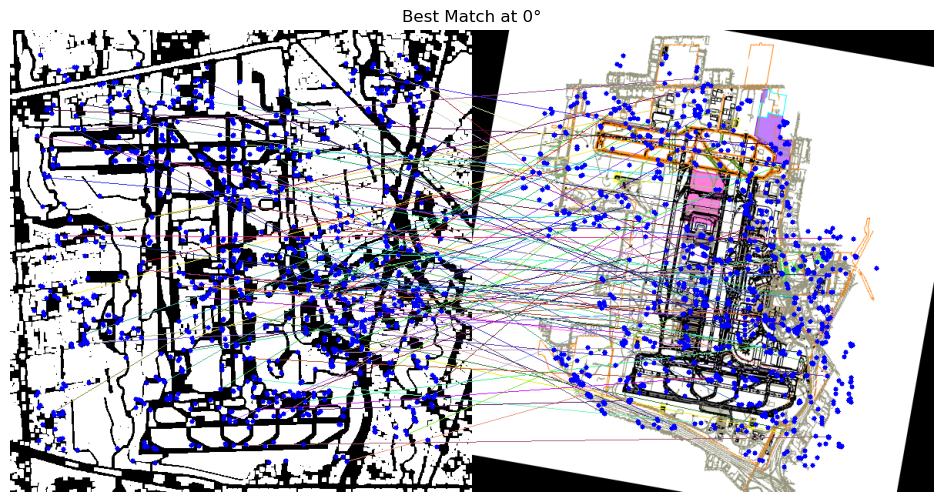

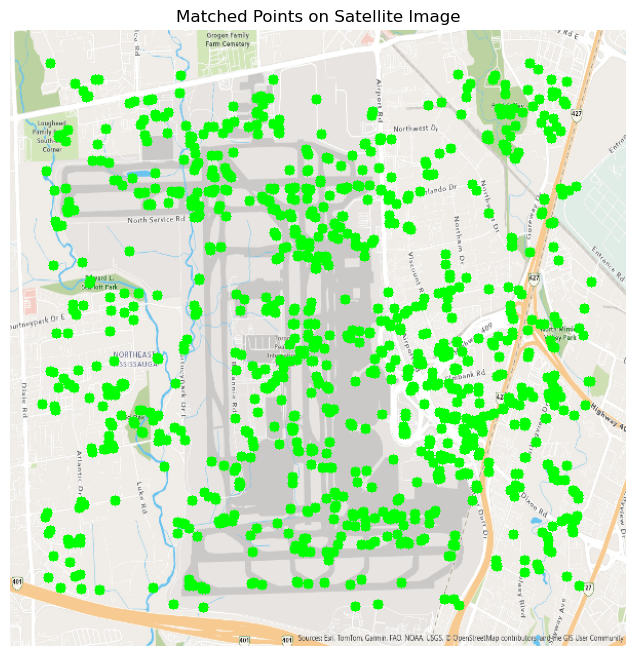

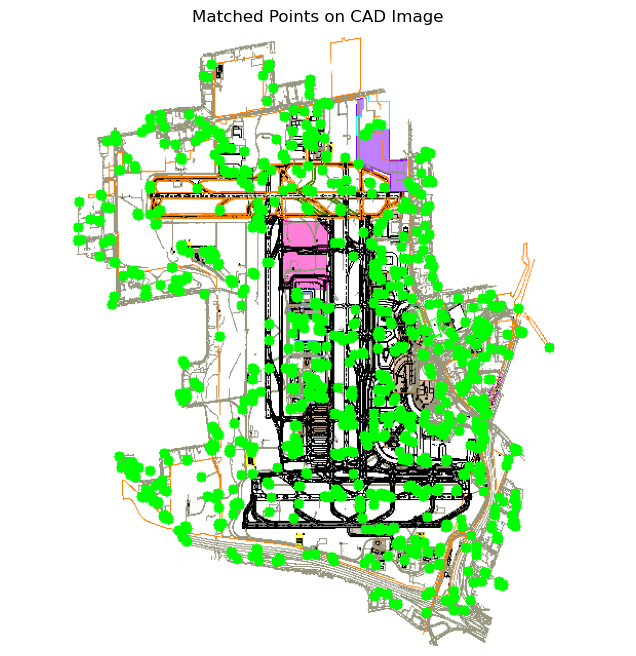

In [162]:
def preprocess_satellite_image(image):
    """Reduce background noise while preserving main structures."""
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 11, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return clean

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()


# Load images and preprocess only the satellite image
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/community.tif"
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"

img1, gray1, edges1 = load_and_preprocess(satellite_path)  # Preprocessing happens here
img2, gray2, edges2 = load_and_preprocess(cad_path)  # No preprocessing to CAD image

# Preprocess the satellite image
clean1 = preprocess_satellite_image(img1)  # Apply the noise reduction and blur only to the satellite image

# Resize CAD image to match satellite image size
img2_resized = cv2.resize(img2, (img1.shape[1], img1.shape[0]))  # Resizing CAD image to the same size as satellite

# Rotate CAD image to find best alignment (optional)
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    img2_rot_resized = rotate_image(img2_resized, angle)
    matches, kp1, kp2 = match_edge_maps(clean1, edges2_rot)  # Use the preprocessed satellite image
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

if best_matches:
    visualize_matches(clean1, best_kp1, img2_rot_resized, best_kp2, best_matches, f"Best Match at {best_angle}°")

# Map matched points back onto original images
map_matched_points(img1, best_kp1, "Matched Points on Satellite Image")
map_matched_points(img2_resized, best_kp2, "Matched Points on CAD Image")


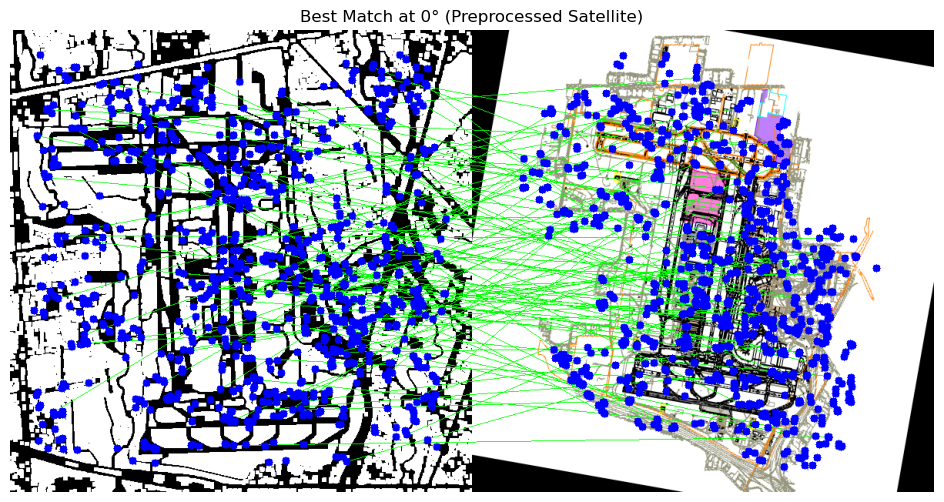

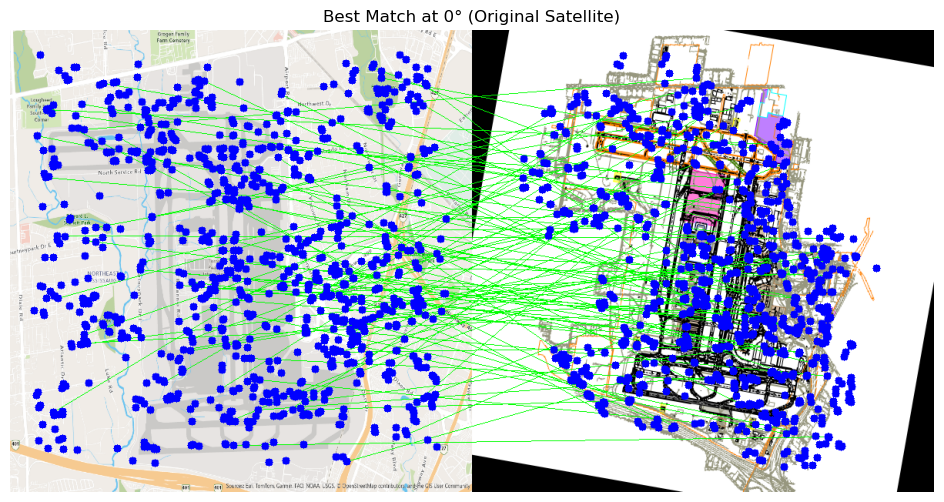

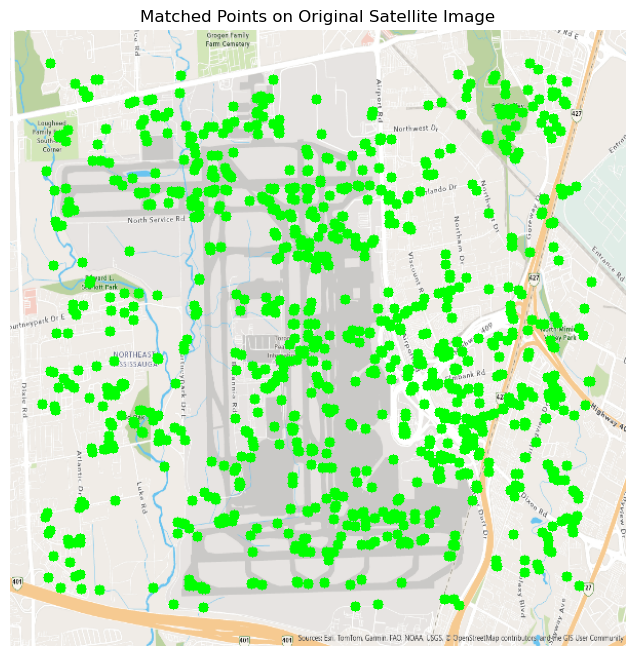

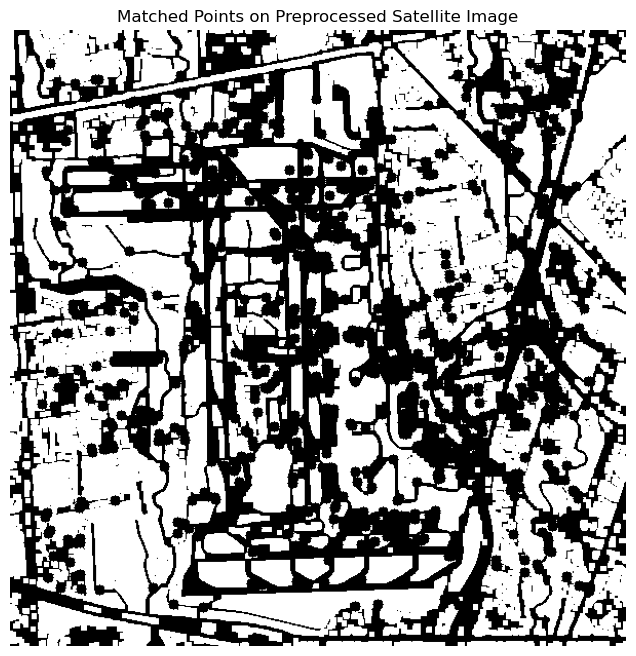

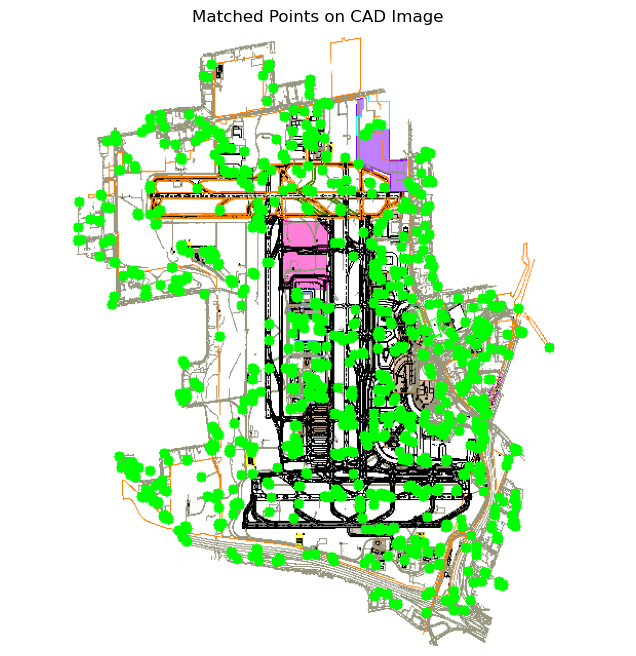

In [163]:
def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with smaller lines and constrained to image boundaries."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to 3-channel for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Draw lines between keypoints (ensure they stay within bounds)
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Limit the lines within the bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Draw smaller lines with thinner thickness (adjust as needed)
        cv2.line(canvas, (x1, y1), (x2, y2), (0, 255, 0), 1)  # Line thickness set to 1
    
    # Draw keypoints on both images
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 5, (255, 0, 0), -1)  # Keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 5, (255, 0, 0), -1)  # Keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images and preprocess only the satellite image
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/community.tif"
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"

img1, gray1, edges1 = load_and_preprocess(satellite_path)  # Preprocessing happens here
img2, gray2, edges2 = load_and_preprocess(cad_path)  # No preprocessing to CAD image

# Preprocess the satellite image
clean1 = preprocess_satellite_image(img1)  # Apply the noise reduction and blur only to the satellite image

# Resize CAD image to match satellite image size
img2_resized = cv2.resize(img2, (img1.shape[1], img1.shape[0]))  # Resizing CAD image to the same size as satellite

# Rotate CAD image to find best alignment (optional)
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    img2_rot_resized = rotate_image(img2_resized, angle)
    matches, kp1, kp2 = match_edge_maps(clean1, edges2_rot)  # Use the preprocessed satellite image
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

# Visualize matches for both preprocessed and original satellite images
if best_matches:
    visualize_matches(clean1, best_kp1, img2_rot_resized, best_kp2, best_matches, f"Best Match at {best_angle}° (Preprocessed Satellite)")

    # Visualize matches using the original satellite image (without preprocessing)
    visualize_matches(img1, best_kp1, img2_rot_resized, best_kp2, best_matches, f"Best Match at {best_angle}° (Original Satellite)")

# Map matched points back onto original images
map_matched_points(img1, best_kp1, "Matched Points on Original Satellite Image")
map_matched_points(clean1, best_kp1, "Matched Points on Preprocessed Satellite Image")
map_matched_points(img2_resized, best_kp2, "Matched Points on CAD Image")


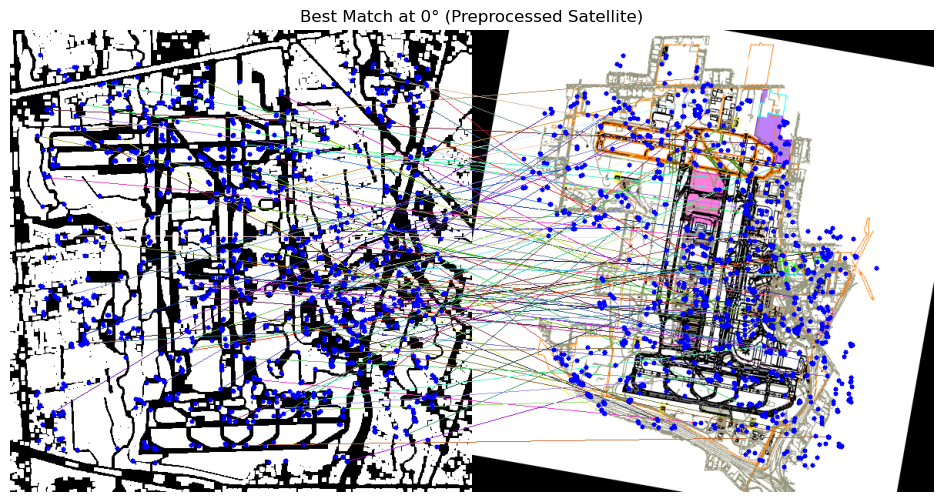

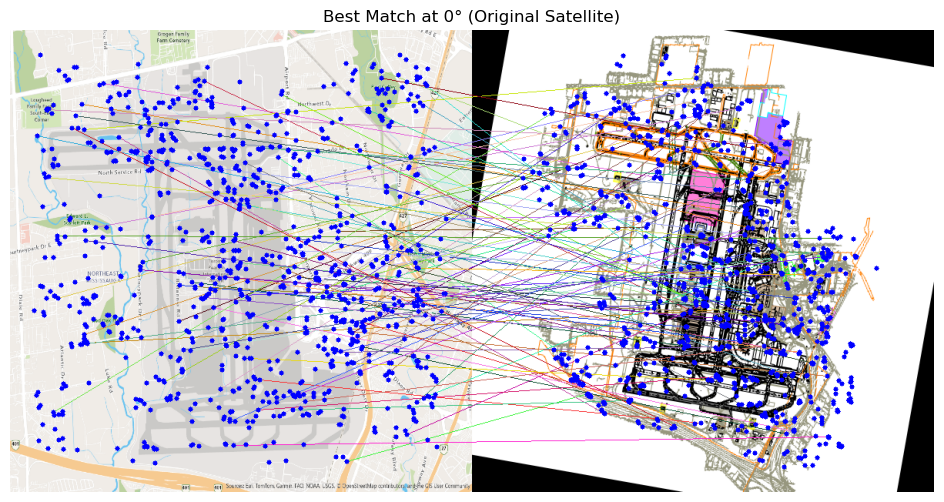

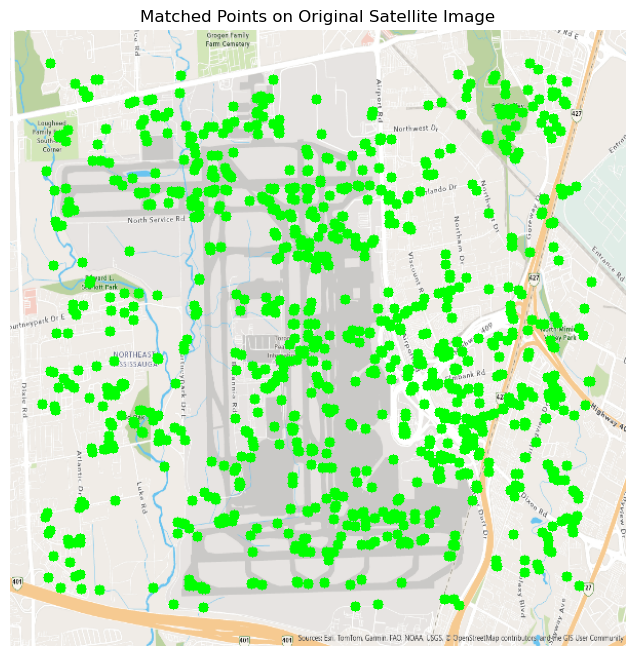

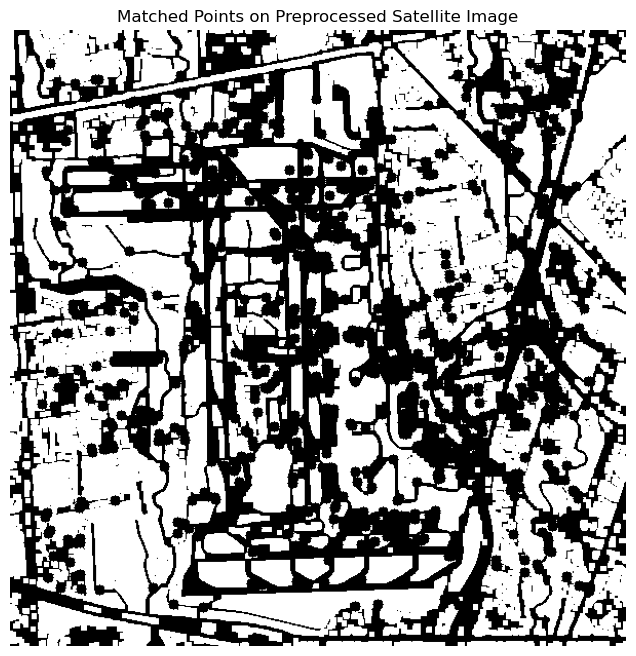

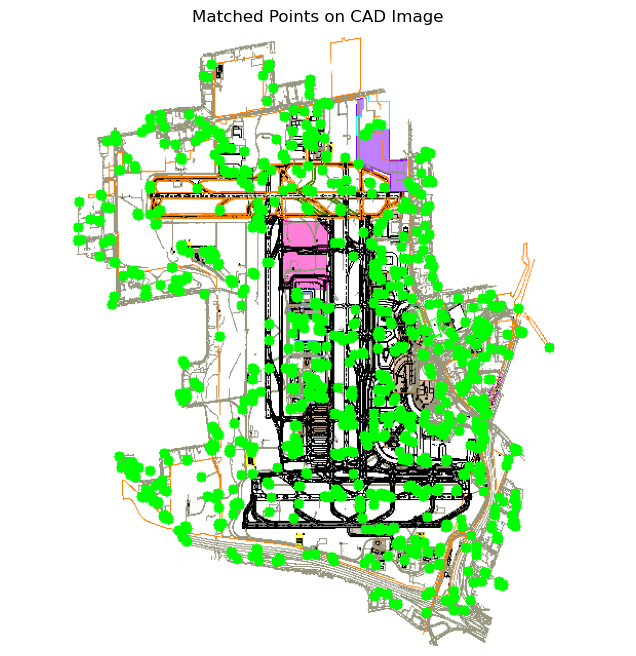

In [164]:
import random

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side with multicolored lines and smaller points."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    # Convert grayscale images to BGR for visualization
    if len(img1.shape) == 2:  # Grayscale to BGR
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:  # Grayscale to BGR
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Create a canvas with enough space to fit both images side by side
    new_h = max(h1, h2)
    new_w = w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    
    # Place images side by side
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    # Draw matches between the two images with random colors
    for match in matches:
        # Get matched keypoints
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        
        # Adjust keypoints for image2 to align on the canvas
        kp2_pt = (kp2_pt[0] + w1, kp2_pt[1])  # Shift keypoints of image2

        # Limit the lines within the bounds of the canvas
        x1, y1 = int(kp1_pt[0]), int(kp1_pt[1])
        x2, y2 = int(kp2_pt[0]), int(kp2_pt[1])

        # Ensure the lines stay within bounds of the canvas
        x1, y1 = max(0, min(w1-1, x1)), max(0, min(h1-1, y1))
        x2, y2 = max(w1, min(w1+w2-1, x2)), max(0, min(h2-1, y2))

        # Generate a random color for each line
        color = generate_random_color()

        # Draw the line with random color and thinner thickness
        cv2.line(canvas, (x1, y1), (x2, y2), color, 1)  # Line thickness set to 1
    
    # Draw smaller keypoints (size reduced)
    for kp in kp1:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image1

    for kp in kp2:
        x, y = int(kp.pt[0] + w1), int(kp.pt[1])
        cv2.circle(canvas, (x, y), 3, (255, 0, 0), -1)  # Smaller keypoints for image2

    # Plot the final image with both images side by side
    plt.figure(figsize=(12, 6))  # Regular sized figure for clarity
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images and preprocess only the satellite image
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/community.tif"
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"

img1, gray1, edges1 = load_and_preprocess(satellite_path)  # Preprocessing happens here
img2, gray2, edges2 = load_and_preprocess(cad_path)  # No preprocessing to CAD image

# Preprocess the satellite image
clean1 = preprocess_satellite_image(img1)  # Apply the noise reduction and blur only to the satellite image

# Resize CAD image to match satellite image size
img2_resized = cv2.resize(img2, (img1.shape[1], img1.shape[0]))  # Resizing CAD image to the same size as satellite

# Rotate CAD image to find best alignment (optional)
best_matches = []
best_kp1, best_kp2 = [], []
best_angle = 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    img2_rot_resized = rotate_image(img2_resized, angle)
    matches, kp1, kp2 = match_edge_maps(clean1, edges2_rot)  # Use the preprocessed satellite image
    if matches and len(matches) > len(best_matches):
        best_matches = matches
        best_kp1, best_kp2 = kp1, kp2
        best_angle = angle

# Visualize matches for both preprocessed and original satellite images
if best_matches:
    visualize_matches(clean1, best_kp1, img2_rot_resized, best_kp2, best_matches, f"Best Match at {best_angle}° (Preprocessed Satellite)")

    # Visualize matches using the original satellite image (without preprocessing)
    visualize_matches(img1, best_kp1, img2_rot_resized, best_kp2, best_matches, f"Best Match at {best_angle}° (Original Satellite)")

# Map matched points back onto original images
map_matched_points(img1, best_kp1, "Matched Points on Original Satellite Image")
map_matched_points(clean1, best_kp1, "Matched Points on Preprocessed Satellite Image")
map_matched_points(img2_resized, best_kp2, "Matched Points on CAD Image")


In [ ]:
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt

def generate_random_color():
    """Generate a random color for the lines."""
    return tuple(random.randint(0, 255) for _ in range(3))

def rotate_keypoints(kp_list, angle, center, img_shape):
    """Rotate keypoints around the given center point."""
    h, w = img_shape[:2]
    M = cv2.getRotationMatrix2D(center, angle, 1.0)  # Rotation matrix
    rotated_kp = []

    for i, kp in enumerate(kp_list):
        x, y = kp.pt
        new_coords = np.dot(M, np.array([x, y, 1]))  # Apply transformation

        if 0 <= new_coords[0] < w and 0 <= new_coords[1] < h:
            rotated_kp.append(cv2.KeyPoint(new_coords[0], new_coords[1], kp.size))

    return rotated_kp

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2

    canvas = np.zeros((max(h1, h2), w1 + w2, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1 + w2] = img2

    valid_matches = []
    
    for match in matches:
        if match.queryIdx < len(kp1) and match.trainIdx < len(kp2):  # Ensure indices are in range
            valid_matches.append(match)

    for match in valid_matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = kp2[match.trainIdx].pt
        kp2_shifted = (kp2_pt[0] + w1, kp2_pt[1])

        color = generate_random_color()
        cv2.line(canvas, (int(kp1_pt[0]), int(kp1_pt[1])), (int(kp2_shifted[0]), int(kp2_shifted[1])), color, 1)

    for kp in kp1:
        cv2.circle(canvas, (int(kp.pt[0]), int(kp.pt[1])), 3, (255, 0, 0), -1)
    for kp in kp2:
        kp2_shifted = (int(kp.pt[0] + w1), int(kp.pt[1]))
        cv2.circle(canvas, kp2_shifted, 3, (255, 0, 0), -1)

    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load images
satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/darkmap.tif"  # E
cad_path = r"C:\Users\twool\Downloads\GTAA_ungeoreferenced.tif"

img1, gray1, edges1 = load_and_preprocess(satellite_path)
img2, gray2, edges2 = load_and_preprocess(cad_path)

clean1 = preprocess_satellite_image(img1)
img2_resized = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

best_per_angle = {}

for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    img2_rot_resized = rotate_image(img2_resized, angle)

    matches, kp1, kp2 = match_edge_maps(clean1, edges2_rot)

    if matches:
        # Transform keypoints correctly after rotation
        center = (img2.shape[1] // 2, img2.shape[0] // 2)
        kp2_rotated = rotate_keypoints(kp2, angle, center, img2.shape)

        # Ensure matches do not exceed keypoint lists
        valid_matches = [m for m in matches if m.queryIdx < len(kp1) and m.trainIdx < len(kp2_rotated)]
        
        match_count = len(valid_matches)

        if angle not in best_per_angle or match_count > best_per_angle[angle][2]:
            best_per_angle[angle] = (valid_matches, kp1, kp2_rotated, match_count, img2_rot_resized)

# Sort by best matches and visualize
sorted_best_matches = sorted(best_per_angle.values(), key=lambda x: x[3], reverse=True)[:20]

for i, (matches, kp1, kp2, match_count, img2_rot_resized) in enumerate(sorted_best_matches):
    visualize_matches(clean1, kp1, img2_rot_resized, kp2, matches, 
                      f"Best Match {i+1} at {angle}° (Preprocessed)")
    visualize_matches(img1, kp1, img2_rot_resized, kp2, matches, 
                      f"Best Match {i+1} at {angle}° (Original)")

# Take the absolute best match and map points
best_match = sorted_best_matches[0]
map_matched_points(img1, best_match[1], "Matched Points on Original Satellite Image")
map_matched_points(clean1, best_match[1], "Matched Points on Preprocessed Satellite Image")
map_matched_points(img2_resized, best_match[2], "Matched Points on CAD Image")


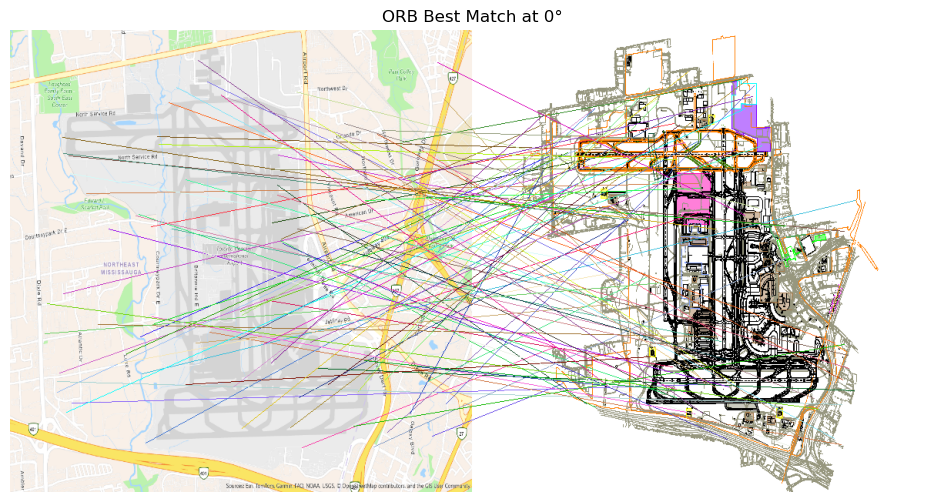

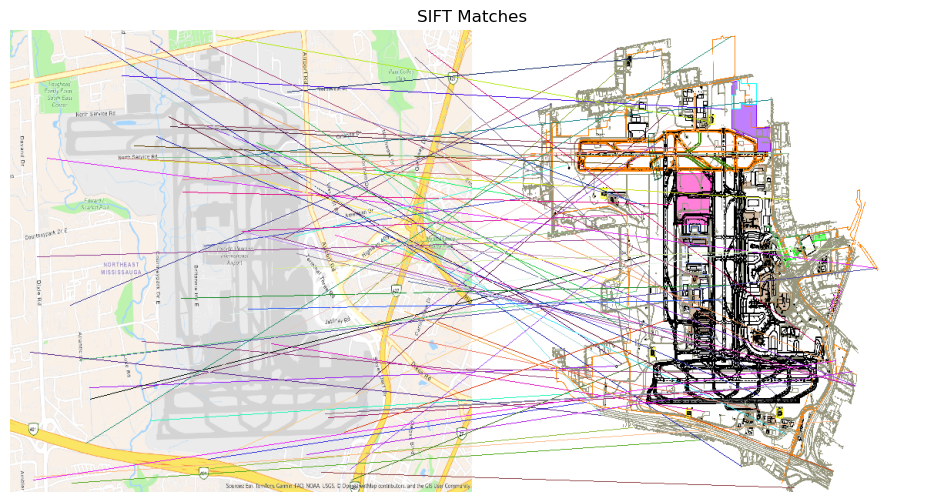

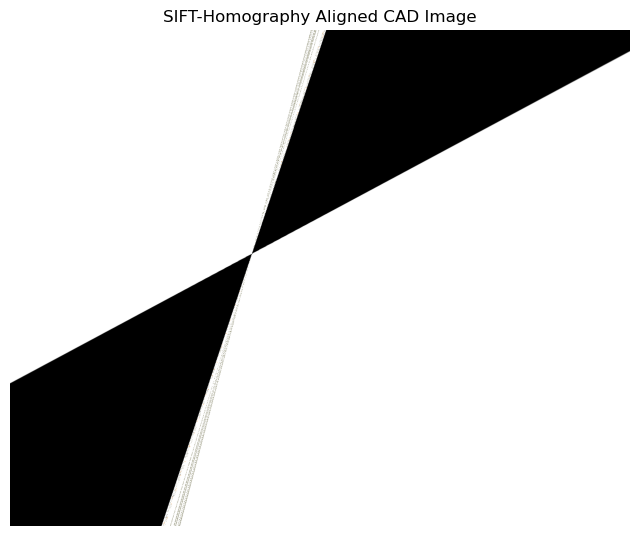

In [214]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def preprocess_image(image, target_size=(600, 600)):
    """Reduce background noise while preserving main structures for both satellite and CAD images."""
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    """Rotate image by a given angle without cropping."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    """Match keypoints using ORB or SIFT."""
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, threshold=10):
    """Remove matches where lines overlap too frequently."""
    filtered_matches = []
    drawn_segments = []
    
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        
        overlaps = sum(1 for seg in drawn_segments if np.linalg.norm(np.array(p1) - np.array(seg[0])) < threshold and
                                                          np.linalg.norm(np.array(p2) - np.array(seg[1])) < threshold)
        if overlaps < 3:
            filtered_matches.append(match)
            drawn_segments.append((p1, p2))
    
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    """Draw and visualize matched keypoints side by side."""
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/navigation.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


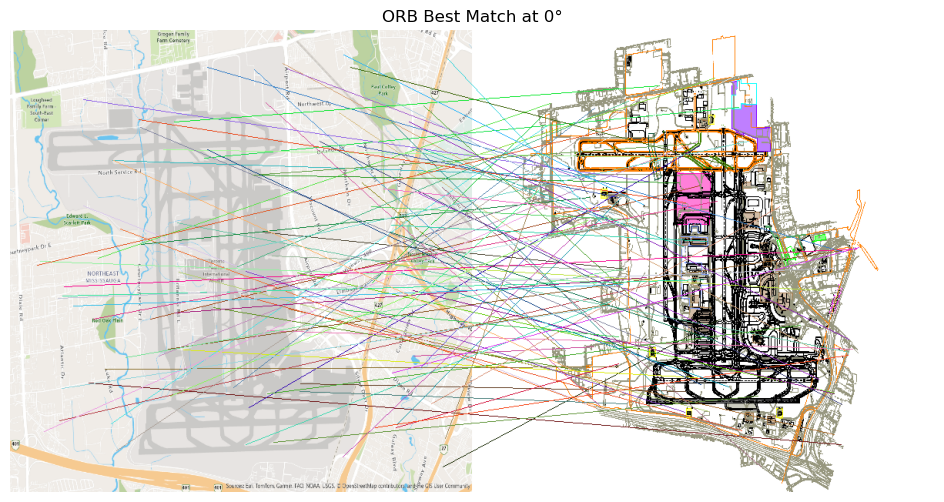

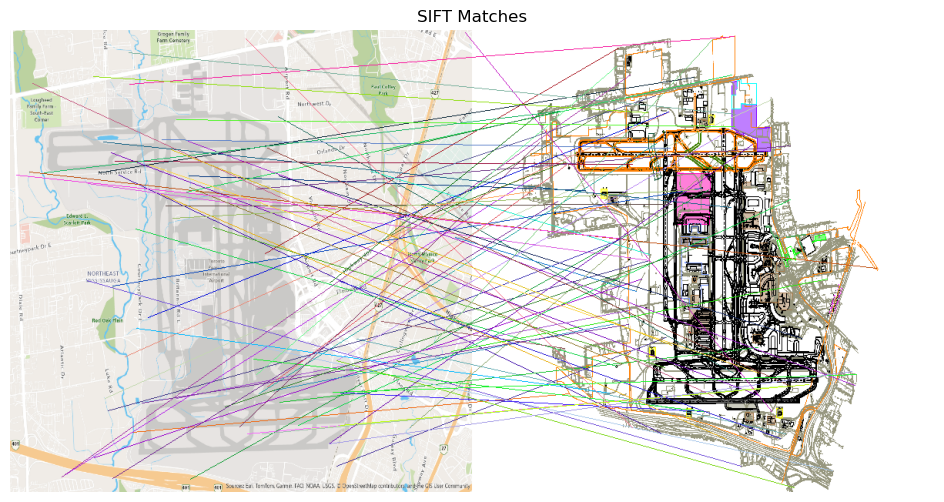

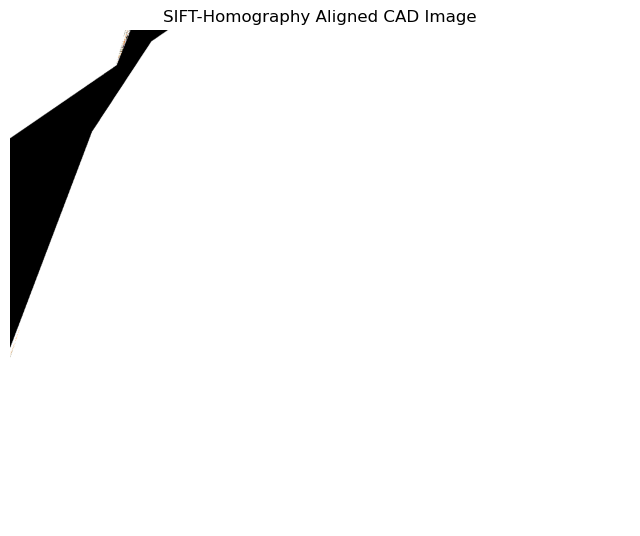

In [166]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/community.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


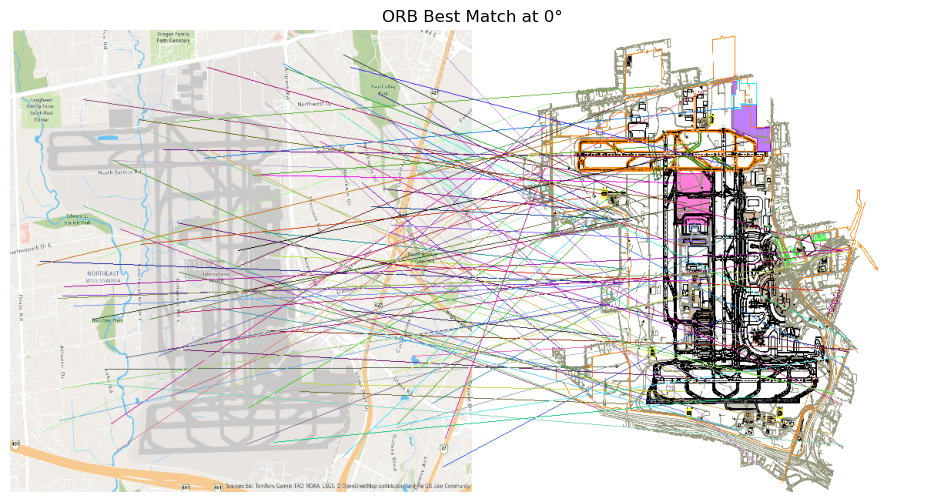

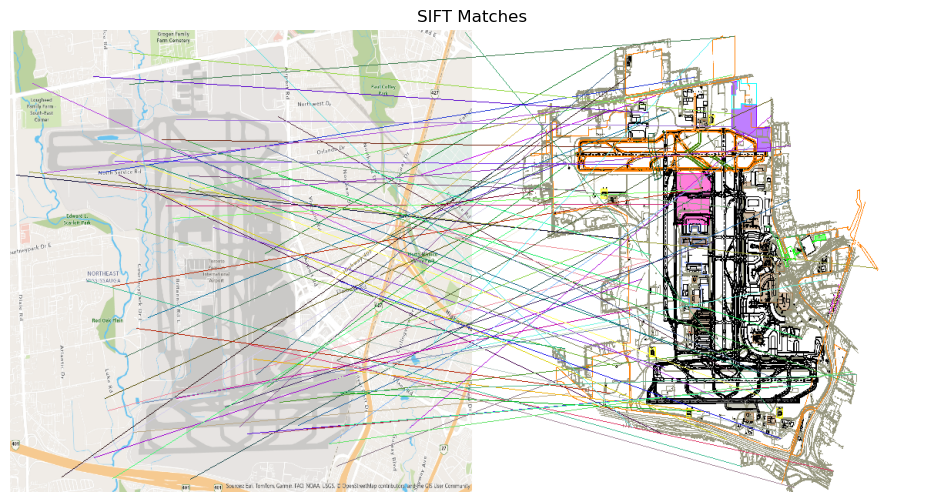

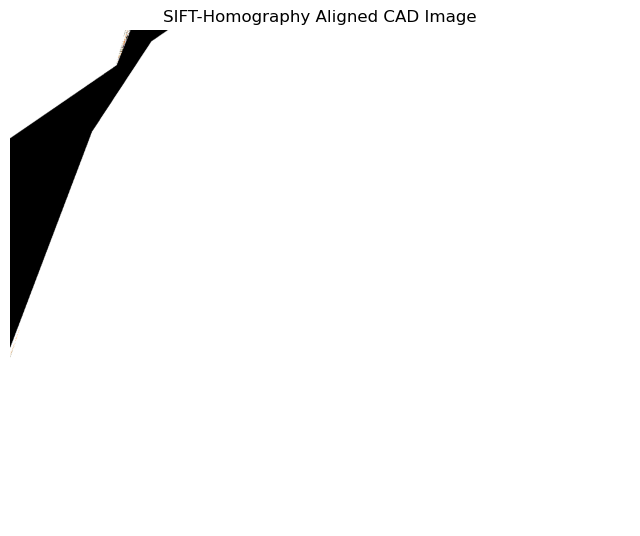

In [168]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/TIFF GTAA Georeferenced/TIFF GTAA Georeferenced/community.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees counterclockwise
edges2 = rotate_image(edges2, 0)
img2_processed = rotate_image(img2_processed, 0)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_overlapping_matches(matches_sift, kp1_sift, kp2_sift)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
    src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
    dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is not None:
        aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
        plt.title("SIFT-Homography Aligned CAD Image")
        plt.axis('off')
        plt.show()


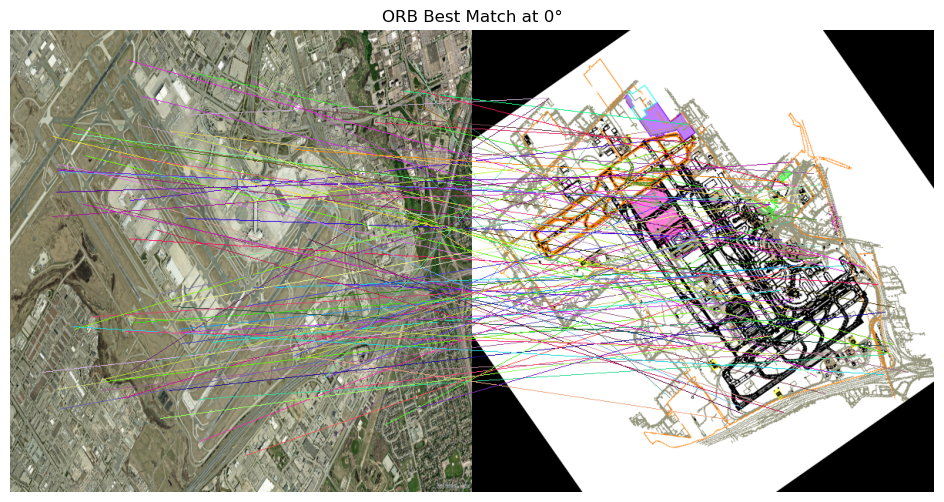

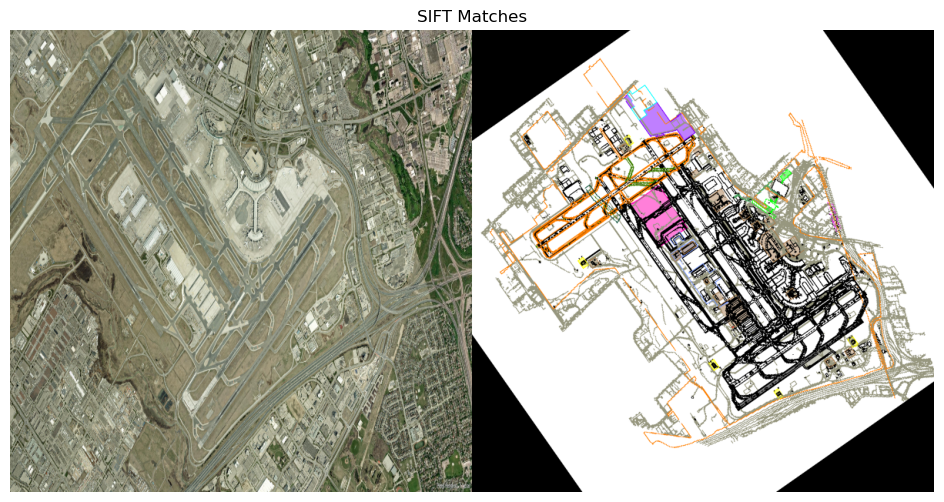

<class 'cv2.error'>: OpenCV(4.8.1) C:\conda\conda-bld\libopencv_1725467512925\work\modules\calib3d\src\fundam.cpp:378: error: (-5:Bad argument) The input arrays should be 2D or 3D point sets in function 'cv::findHomography'


In [296]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from sklearn.cluster import DBSCAN

def preprocess_image(image, target_size=(600, 600)):
    img_resized = cv2.resize(image, target_size)
    gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    binary = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 15, 2)
    kernel = np.ones((3, 3), np.uint8)
    clean = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)
    return img_resized, gray, clean

def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(image, M, (w, h))

def match_edge_maps(edges1, edges2, method="ORB"):
    if method == "ORB":
        detector = cv2.ORB_create(nfeatures=1000)
    else:
        detector = cv2.SIFT_create()
    
    kp1, des1 = detector.detectAndCompute(edges1, None)
    kp2, des2 = detector.detectAndCompute(edges2, None)
    
    if des1 is None or des2 is None:
        return None, [], []
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING if method == "ORB" else cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)[:100]
    
    return matches, kp1, kp2

def filter_overlapping_matches(matches, kp1, kp2, eps=15):
    points = np.array([(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1],
                        kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches])
    if len(points) == 0:
        return []
    clustering = DBSCAN(eps=eps, min_samples=1).fit(points)
    unique_labels = set(clustering.labels_)
    filtered_matches = []
    for label in unique_labels:
        indices = np.where(clustering.labels_ == label)[0]
        filtered_matches.append(matches[indices[0]])  # Pick one representative match per cluster
    return filtered_matches

def filter_extreme_slope_and_long_matches(matches, kp1, kp2, max_angle=45, max_distance_ratio=0.1):
    """Filter matches to remove those with extreme slopes or excessive distances."""
    filtered_matches = []
    max_distance = 0  # To track the longest distance
    
    # First pass: calculate the maximum distance
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        distance = calculate_distance(p1, p2)
        max_distance = max(max_distance, distance)
    
    # Second pass: filter based on slope and distance
    for match in matches:
        p1 = tuple(map(int, kp1[match.queryIdx].pt))
        p2 = tuple(map(int, kp2[match.trainIdx].pt))
        
        # Calculate the angle of the line formed by the match (p1, p2)
        angle = calculate_angle(p1, p2)
        
        # Calculate the Euclidean distance between the points
        distance = calculate_distance(p1, p2)
        
        # Keep match only if:
        # 1. The angle is less than the max_angle threshold (not too steep)
        # 2. The distance is within a certain ratio of the max distance (not too long)
        if abs(angle) <= max_angle and distance <= max_distance * max_distance_ratio:
            filtered_matches.append(match)
    
    return filtered_matches

def filter_quadrant_matches(matches, kp1, kp2, img1_shape, img2_shape):
    """Filter matches to ensure that points are within the same quadrant in both images."""
    h1, w1 = img1_shape[:2]  # Ignore the channel dimension
    h2, w2 = img2_shape[:2]  # Ignore the channel dimension
    
    valid_matches = []
    for match in matches:
        p1 = kp1[match.queryIdx].pt
        p2 = kp2[match.trainIdx].pt
        
        # Determine quadrants for both images
        quadrant1 = (p1[0] < w1 // 2, p1[1] < h1 // 2)
        quadrant2 = (p2[0] < w2 // 2, p2[1] < h2 // 2)
        
        # Keep match only if they are in the same quadrant
        if quadrant1 == quadrant2:
            valid_matches.append(match)
    
    return valid_matches

def visualize_matches(img1, kp1, img2, kp2, matches, title):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR) if len(img1.shape) == 2 else img1
    img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR) if len(img2.shape) == 2 else img2
    
    new_h, new_w = max(h1, h2), w1 + w2
    canvas = np.zeros((new_h, new_w, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:w1+w2] = img2
    
    for match in matches:
        kp1_pt = kp1[match.queryIdx].pt
        kp2_pt = (kp2[match.trainIdx].pt[0] + w1, kp2[match.trainIdx].pt[1])
        color = tuple(random.randint(0, 255) for _ in range(3))
        cv2.line(canvas, tuple(map(int, kp1_pt)), tuple(map(int, kp2_pt)), color, 1)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

satellite_path = "C:/Users/twool/Downloads/GTAA.tif"
cad_path = "C:/Users/twool/Downloads/GTAA_ungeoreferenced.tif"
img1 = cv2.imread(satellite_path)
img2 = cv2.imread(cad_path)
img1_processed, gray1, edges1 = preprocess_image(img1)
img2_processed, gray2, edges2 = preprocess_image(img2)

# Rotate CAD image 35 degrees clockwise
edges2 = rotate_image(edges2, 35)
img2_processed = rotate_image(img2_processed, 35)

best_matches, best_kp1, best_kp2, best_angle = [], [], [], 0
for angle in range(0, 360, 10):
    edges2_rot = rotate_image(edges2, angle)
    matches, kp1, kp2 = match_edge_maps(edges1, edges2_rot, method="ORB")
    if matches and len(matches) > len(best_matches):
        best_matches, best_kp1, best_kp2, best_angle = matches, kp1, kp2, angle

best_matches = filter_overlapping_matches(best_matches, best_kp1, best_kp2)
visualize_matches(img1_processed, best_kp1, img2_processed, best_kp2, best_matches, f"ORB Best Match at {best_angle}°")

matches_sift, kp1_sift, kp2_sift = match_edge_maps(edges1, edges2, method="SIFT")
if matches_sift:
    matches_sift = filter_quadrant_matches(matches_sift, kp1_sift, kp2_sift, img1.shape, img2.shape)
    matches_sift = filter_extreme_slope_and_long_matches(matches_sift, kp1_sift, kp2_sift, max_angle=45, max_distance_ratio=0.1)
    visualize_matches(img1_processed, kp1_sift, img2_processed, kp2_sift, matches_sift, "SIFT Matches")
    
src_pts = np.array([kp1_sift[m.queryIdx].pt for m in matches_sift], dtype=np.float32)
dst_pts = np.array([kp2_sift[m.trainIdx].pt for m in matches_sift], dtype=np.float32)
H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
if H is not None:
    aligned_cad = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(aligned_cad, cv2.COLOR_BGR2RGB))
    plt.title("SIFT-Homography Aligned CAD Image")
    plt.axis('off')
    plt.show()
